In [2]:
import opendatasets as od
import pandas

od.download("https://www.kaggle.com/datasets/usaf/world-war-ii")

Skipping, found downloaded files in ".\world-war-ii" (use force=True to force download)


In [146]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns # visualization library
import matplotlib.pyplot as plt # visualization library
import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot # plotly offline mode
init_notebook_mode(connected=True)
import plotly.graph_objs as go # plotly graphical object

from statsmodels.tsa.seasonal import * 
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
from statsmodels.graphics.tsaplots import plot_acf , plot_pacf
from sklearn.model_selection import TimeSeriesSplit

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list the files in the input directory
import os
# import warnings library
import warnings
# ignore filters
warnings.filterwarnings("ignore") # if there is a warning after some codes, this will avoid us to see them.
plt.style.use('ggplot') # style of plots. ggplot is one of the most used style, I also like it.
# Any results you write to the current directory are saved as output.
import plotly.express as px
%matplotlib inline

In [4]:
aerial = pd.read_csv('operations.csv')
weather_station_location = pd.read_csv("Weather Station Locations.csv")
weather = pd.read_csv('Summary of Weather.csv')

In [5]:
aerial.head()

,Mission ID,Mission Date,Theater of Operations,Country,Air Force,Unit ID,Aircraft Series,Callsign,Mission Type,Takeoff Base,...,Incendiary Devices Weight (Tons),Fragmentation Devices,Fragmentation Devices Type,Fragmentation Devices Weight (Pounds),Fragmentation Devices Weight (Tons),Total Weight (Pounds),Total Weight (Tons),Time Over Target,Bomb Damage Assessment,Source ID
0,1,8/15/1943,MTO,USA,12 AF,27 FBG/86 FBG,A36,NaN,NaN,PONTE OLIVO AIRFIELD,...,NaN,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN
1,2,8/15/1943,PTO,USA,5 AF,400 BS,B24,NaN,1,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,20.0,NaN,NaN,9366.0
2,3,8/15/1943,MTO,USA,12 AF,27 FBG/86 FBG,A36,NaN,NaN,PONTE OLIVO AIRFIELD,...,NaN,NaN,NaN,NaN,NaN,NaN,9.0,NaN,NaN,NaN
3,4,8/15/1943,MTO,USA,12 AF,27 FBG/86 FBG,A36,NaN,NaN,PONTE OLIVO AIRFIELD,...,NaN,NaN,NaN,NaN,NaN,NaN,7.5,NaN,NaN,NaN
4,5,8/15/1943,PTO,USA,5 AF,321 BS,B24,NaN,1,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,8.0,NaN,NaN,22585.0


In [6]:
weather_station_location.head()

,WBAN,NAME,STATE/COUNTRY ID,LAT,LON,ELEV,Latitude,Longitude
0,33013,AIN EL,AL,3623N,00637E,611,36.383333,6.650000
1,33031,LA SENIA,AL,3537N,00037E,88,35.616667,0.583333
2,33023,MAISON BLANCHE,AL,3643N,00314E,23,36.716667,3.216667
3,33044,TELERGMA,AL,3607N,00621E,754,36.116667,6.416667
4,12001,TINDOUF,AL,2741N,00809W,443,27.683333,-8.083333


In [7]:
aerial = aerial[pd.isna(aerial['Country'])==False]
aerial = aerial[pd.isna(aerial['Target Latitude'])==False]
aerial = aerial[pd.isna(aerial['Target Longitude'])==False]

In [8]:
aerial["Country"].unique()

array(['USA', 'GREAT BRITAIN', 'NEW ZEALAND', 'SOUTH AFRICA', 'AUSTRALIA'],
      dtype=object)

In [9]:
#droping useless information
drop_list = ['Mission ID','Unit ID','Target ID','Altitude (Hundreds of Feet)','Airborne Aircraft',
             'Attacking Aircraft', 'Bombing Aircraft', 'Aircraft Returned',
             'Aircraft Failed', 'Aircraft Damaged', 'Aircraft Lost',
             'High Explosives', 'High Explosives Type','Mission Type',
             'High Explosives Weight (Pounds)', 'High Explosives Weight (Tons)',
             'Incendiary Devices', 'Incendiary Devices Type',
             'Incendiary Devices Weight (Pounds)',
             'Incendiary Devices Weight (Tons)', 'Fragmentation Devices',
             'Fragmentation Devices Type', 'Fragmentation Devices Weight (Pounds)',
             'Fragmentation Devices Weight (Tons)', 'Total Weight (Pounds)',
             'Total Weight (Tons)', 'Time Over Target', 'Bomb Damage Assessment','Source ID']
aerial.drop(drop_list, axis=1,inplace = True)

In [10]:
weather_station_location = weather_station_location.loc[:,['WBAN','NAME','STATE/COUNTRY ID','Latitude','Longitude']]
weather_station_location.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   WBAN              161 non-null    int64  
 1   NAME              161 non-null    object 
 2   STATE/COUNTRY ID  161 non-null    object 
 3   Latitude          161 non-null    float64
 4   Longitude         161 non-null    float64
dtypes: float64(2), int64(1), object(2)
memory usage: 6.4+ KB


In [11]:
weather = weather.loc[:,['STA','Date','MeanTemp']]
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119040 entries, 0 to 119039
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   STA       119040 non-null  int64  
 1   Date      119040 non-null  object 
 2   MeanTemp  119040 non-null  float64
dtypes: float64(1), int64(1), object(1)
memory usage: 2.7+ MB


Data Visualisation

Country
USA              94165
GREAT BRITAIN    31361
NEW ZEALAND        633
AUSTRALIA          316
SOUTH AFRICA        19
Name: count, dtype: int64


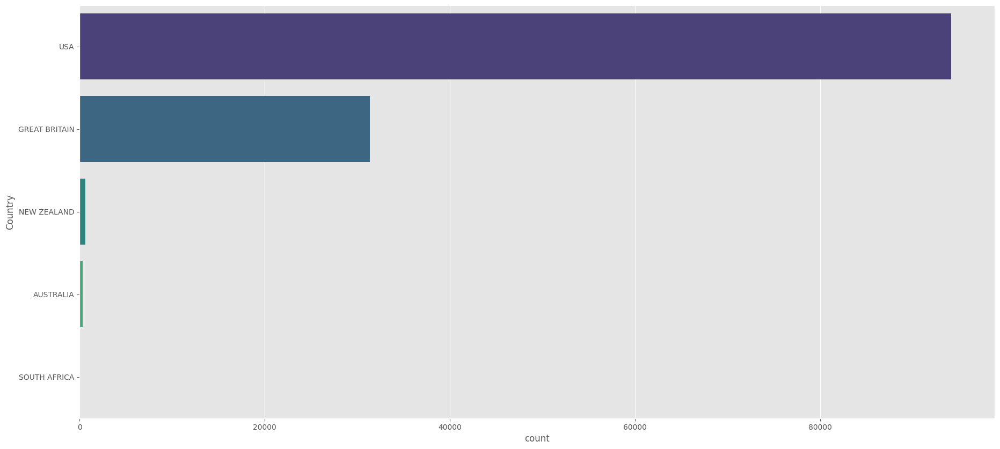

In [184]:
#Countries
aerial = pd.read_csv('operations.csv')
print(aerial['Country'].value_counts())
plt.figure(figsize=(22,10))
sns.countplot(data=aerial['Country'], order=aerial['Country'].value_counts().index, palette='viridis')
plt.show()

Target Country
GERMANY                   61744
ITALY                     23689
FRANCE                    22226
BURMA                      8259
PHILIPPINE ISLANDS         8180
NEW GUINEA                 7213
AUSTRIA                    4380
CHINA                      4060
HOLLAND OR NETHERLANDS     3560
BISMARK ARCHIPELAGO        3484
Name: count, dtype: int64


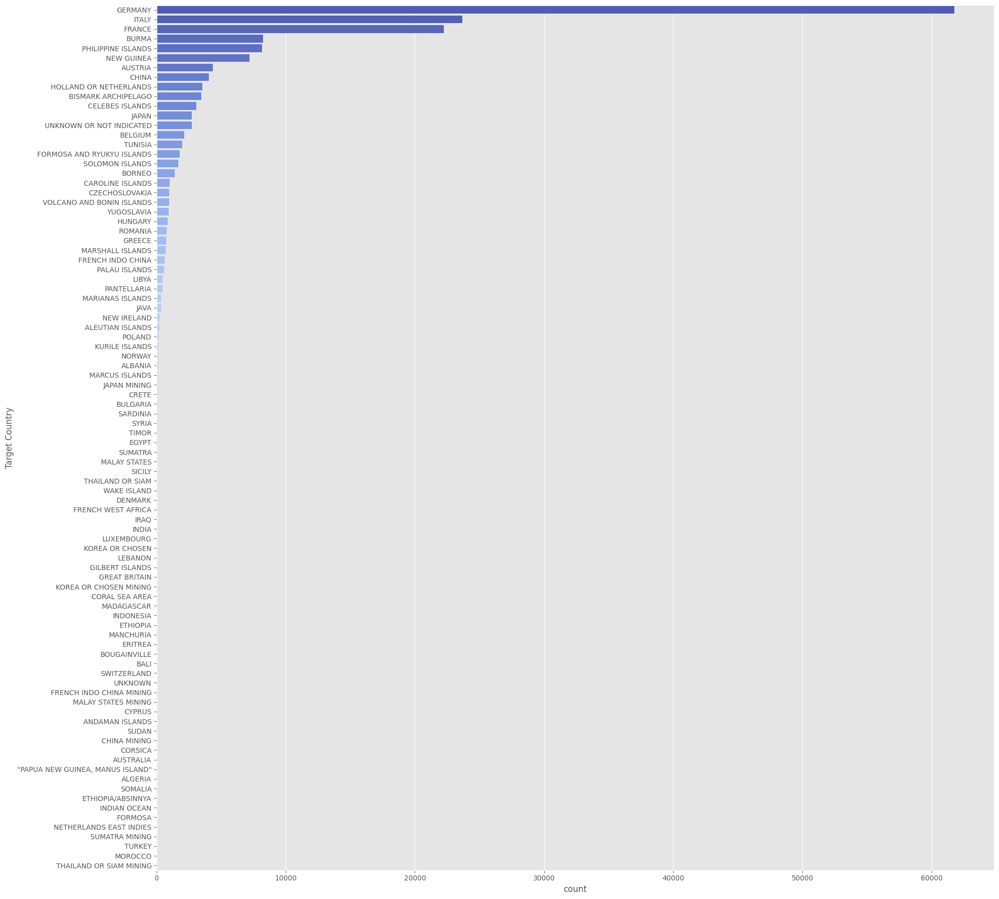

In [202]:
#Targated Countries
print(aerial['Target Country'].value_counts()[:10])
plt.figure(figsize=(20,18))
sns.countplot(data=aerial['Target Country'], order=aerial['Target Country'].value_counts().index, palette='coolwarm')
plt.tight_layout()
plt.show()

Aircraft Series
B24     33837
B17     31448
B25     17359
A20     12561
B26     11980
GB17     9124
WELL     6391
HVY      6298
A26      4736
P47      4660
Name: count, dtype: int64


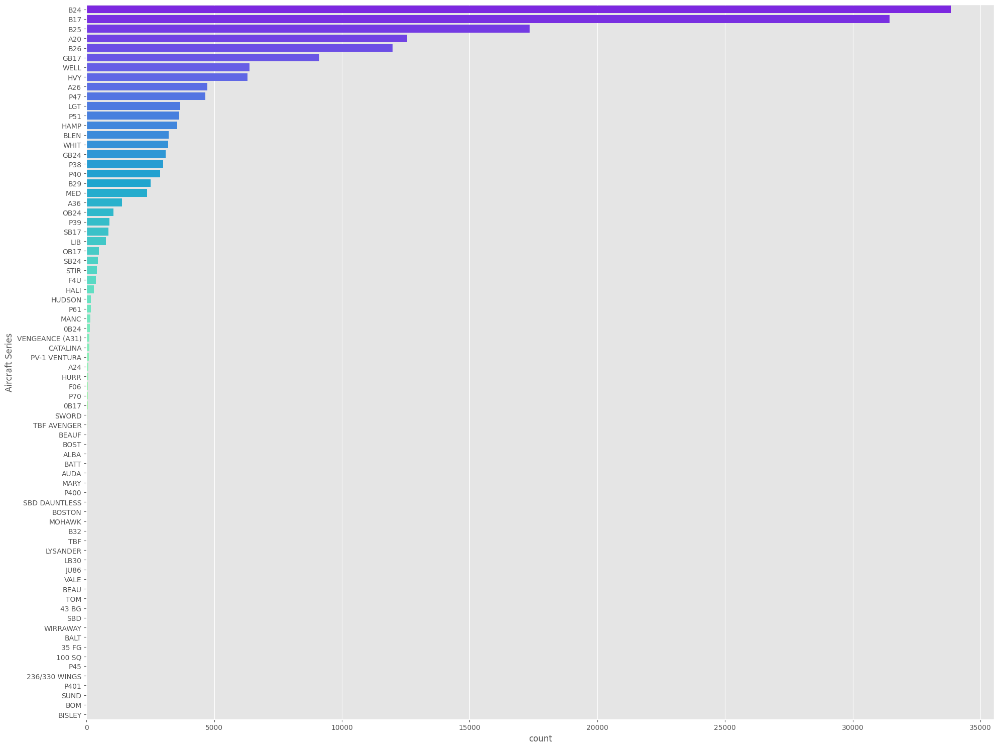

In [203]:
#Aircraft Series
print(aerial['Aircraft Series'].value_counts()[:10])
plt.figure(figsize=(20,15))
sns.countplot(data=aerial['Aircraft Series'], order=aerial['Aircraft Series'].value_counts().index, palette='rainbow')
plt.tight_layout()
plt.show()

In [12]:
aerial["Country"].unique()

array(['USA', 'GREAT BRITAIN', 'NEW ZEALAND', 'SOUTH AFRICA', 'AUSTRALIA'],
      dtype=object)

In [34]:
aerial['color1'] = ''
aerial.color1[aerial.Country == 'USA'] = 'rgb(0,116,217)'
aerial.color1[aerial.Country == 'GREAT BRITAIN'] = 'rgb(255,65,54)'
aerial.color1[aerial.Country == 'NEW ZEALAND'] = 'rgb(133,20,75)'
aerial.color1[aerial.Country == 'SOUTH AFRICA'] = 'rgb(255,133,27)'
aerial.color1[aerial.Country == 'AUSTRALIA'] = 'rgb(100,241,60)'

In [35]:
aerial["color1"].unique()

array(['rgb(0,116,217)', 'rgb(255,65,54)', 'rgb(133,20,75)',
       'rgb(255,133,27)', 'rgb(100,241,60)'], dtype=object)

In [15]:
aerial['Mission Date'] = pd.to_datetime(aerial['Mission Date'])
weather['Date'] = pd.to_datetime(weather['Date'])

In [36]:
# Create scatter plot data
data = [dict(
    type='scattergeo',
    lon=aerial['Takeoff Longitude'],
    lat=aerial['Takeoff Latitude'],
    hoverinfo='text',
    text="Country: " + aerial.Country + " Takeoff Location: " + aerial["Takeoff Location"] + " Takeoff Base: " +
         aerial['Takeoff Base'],
    mode='markers',
    marker=dict(
        sizemode='area',
        sizeref=1,
        size=10,
        line=dict(width=1, color="white"),
        color = aerial['color1'],
        opacity=0.7),
)]

In [37]:
# Define layout
layout = dict(
    title='Countries Take Off Bases ',
    hovermode='closest',
    geo=dict(showframe=False, showland=True, showcoastlines=True, showcountries=True,
             countrywidth=1, projection_type='mercator',
             landcolor='rgb(217, 217, 217)',
             subunitwidth=1,
             showlakes=True,
             lakecolor='rgb(255, 255, 255)',
             countrycolor="rgb(5, 5, 5)")
)

In [38]:
# Create the figure and plot
fig = go.Figure(data=data, layout=layout)
iplot(fig)

In [39]:
aerial['Target Country'].unique()

array(['ITALY', 'NEW GUINEA', 'SUMATRA', 'BURMA', 'GERMANY',
       'CORAL SEA AREA', 'SOLOMON ISLANDS', 'BORNEO', 'CHINA',
       'CAROLINE ISLANDS', 'KURILE ISLANDS', 'CELEBES ISLANDS',
       'MARIANAS ISLANDS', 'BISMARK ARCHIPELAGO', 'MANCHURIA', 'JAVA',
       'VOLCANO AND BONIN ISLANDS', 'PHILIPPINE ISLANDS', 'JAPAN',
       'AUSTRIA', 'FRANCE', 'BELGIUM', 'ALEUTIAN ISLANDS', nan,
       'FORMOSA AND RYUKYU ISLANDS', 'NEW IRELAND', 'MARCUS ISLANDS',
       'GREECE', 'HUNGARY', 'YUGOSLAVIA', 'FRENCH INDO CHINA',
       'MARSHALL ISLANDS', 'PALAU ISLANDS', 'HOLLAND OR NETHERLANDS',
       'MALAY STATES', 'ROMANIA', 'INDIA', 'LUXEMBOURG', 'ALGERIA',
       'NORWAY', 'POLAND', 'GILBERT ISLANDS', 'CRETE',
       'MALAY STATES MINING', 'SUMATRA MINING', 'CZECHOSLOVAKIA',
       'FORMOSA', 'ALBANIA', 'SWITZERLAND', 'UNKNOWN OR NOT INDICATED',
       'CHINA MINING', 'BULGARIA', 'KOREA OR CHOSEN', 'DENMARK',
       'THAILAND OR SIAM', 'GREAT BRITAIN', 'CORSICA', 'LIBYA', 'ERITREA',
      

In [60]:
#Targated Locations
targets = [ dict(
        type = 'scattergeo',
        lon = aerial['Target Longitude'],
        lat = aerial['Target Latitude'],
        hoverinfo = 'text',
        text = "Target Country: "+aerial["Target Country"]+" Target City: "+aerial["Target City"],
        mode = 'markers',
        marker = dict( 
            size=1, 
            color = "red",
            line = dict(
                width=0.5,
                color = "red"
            )
        ))]

In [68]:
layout = dict(
    title = 'Attacked Countries',
    hovermode='closest',
    geo = dict(showframe=False, showland=True, showcoastlines=True, showcountries=True,
               countrywidth=1, projection=dict(type='mercator'),
              landcolor = 'rgb(217, 217, 217)',
              subunitwidth=1,
              showlakes = True,
              lakecolor = 'rgb(255, 255, 255)',
              countrycolor="rgb(5, 5, 5)")
)

In [66]:
fig = dict( data=targets, layout=layout )
iplot( fig )

In [21]:
aerial.head(1)

,Mission Date,Theater of Operations,Country,Air Force,Aircraft Series,Callsign,Takeoff Base,Takeoff Location,Takeoff Latitude,Takeoff Longitude,Target Country,Target City,Target Type,Target Industry,Target Priority,Target Latitude,Target Longitude,color
0,1943-08-15,MTO,USA,12 AF,A36,NaN,PONTE OLIVO AIRFIELD,SICILY,37.131022,14.321464,ITALY,SPADAFORA,NaN,NaN,NaN,38.22,15.37,"rgb(0,116,217)"


<Axes: xlabel='Theater of Operations', ylabel='count'>

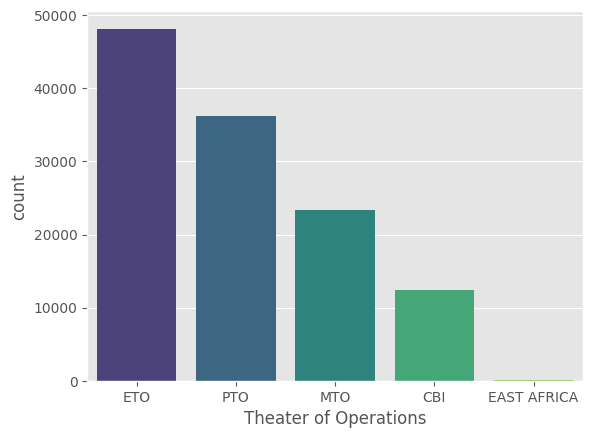

In [50]:
aerial["Theater of Operations"].value_counts()
sns.countplot(x=aerial["Theater of Operations"], order=aerial["Theater of Operations"].value_counts().index, palette='viridis')

In [51]:
weather_station_location.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   WBAN              161 non-null    int64  
 1   NAME              161 non-null    object 
 2   STATE/COUNTRY ID  161 non-null    object 
 3   Latitude          161 non-null    float64
 4   Longitude         161 non-null    float64
dtypes: float64(2), int64(1), object(2)
memory usage: 6.4+ KB


In [70]:
#Weather Station Locations
weather_stations = [dict(
    type = 'scattergeo',
    lon = weather_station_location['Longitude'],
    lat = weather_station_location['Latitude'],
    hoverinfo = 'text',
    text = "Name: " + weather_station_location['NAME'] + " Country: " + weather_station_location['STATE/COUNTRY ID'],
    mode = 'markers',
    marker = dict(
        sizemode = 'area',
        sizeref = 1,
        size= 8 ,
        line = dict(width=1,color = "white"),
        color = "blue",
        opacity = 0.7),
    )]

layout = dict(
    title = 'Weather Station Locations',
    hovermode = 'closest',
    geo = dict(showframe=False, showland=True, showcoastlines=True, showcountries=True,
               countrywidth=1, projection=dict(type='mercator'),
              landcolor = 'rgb(217, 217, 217)',
              subunitwidth=1,
              showlakes = True,
              lakecolor = 'rgb(255, 255, 255)',
              countrycolor="rgb(5, 5, 5)")
)

fig = go.Figure(data = weather_stations, layout = layout)
iplot(fig)

In [84]:
weather_station_location.info()
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 161 entries, 0 to 160
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   WBAN              161 non-null    int64  
 1   NAME              161 non-null    object 
 2   STATE/COUNTRY ID  161 non-null    object 
 3   Latitude          161 non-null    float64
 4   Longitude         161 non-null    float64
dtypes: float64(2), int64(1), object(2)
memory usage: 6.4+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119040 entries, 0 to 119039
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype         
---  ------    --------------   -----         
 0   STA       119040 non-null  int64         
 1   Date      119040 non-null  datetime64[ns]
 2   MeanTemp  119040 non-null  float64       
dtypes: datetime64[ns](1), float64(1), int64(1)
memory usage: 2.7 MB


Focusing on Burma War

Text(0.5, 1.0, 'Mean Temperature in Bindukari')

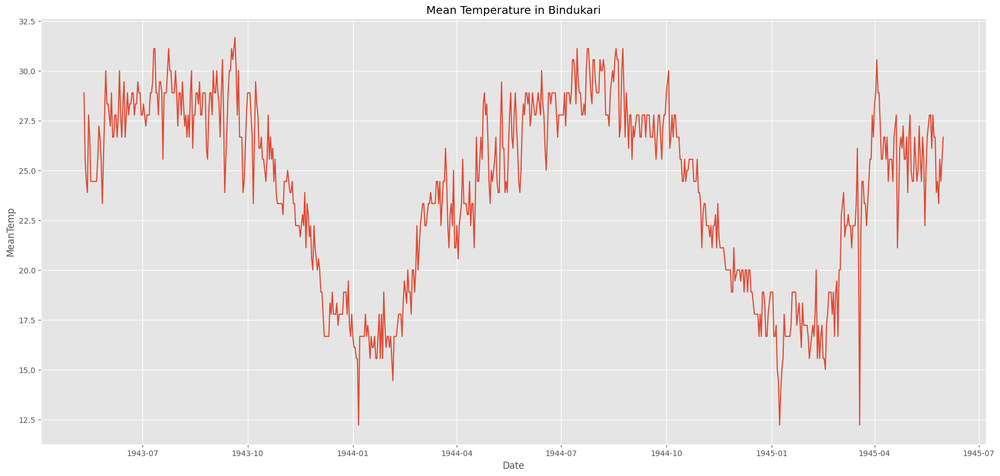

In [91]:
weather_station_id = weather_station_location[weather_station_location['NAME']=="BINDUKARI"].WBAN
weather_bin = weather[weather.STA == 32907]
weather_bin.Date = pd.to_datetime(weather_bin.Date)
plt.figure(figsize=(22,10))
sns.lineplot(x=weather_bin["Date"], y=weather_bin["MeanTemp"])
plt.title("Mean Temperature in Bindukari")

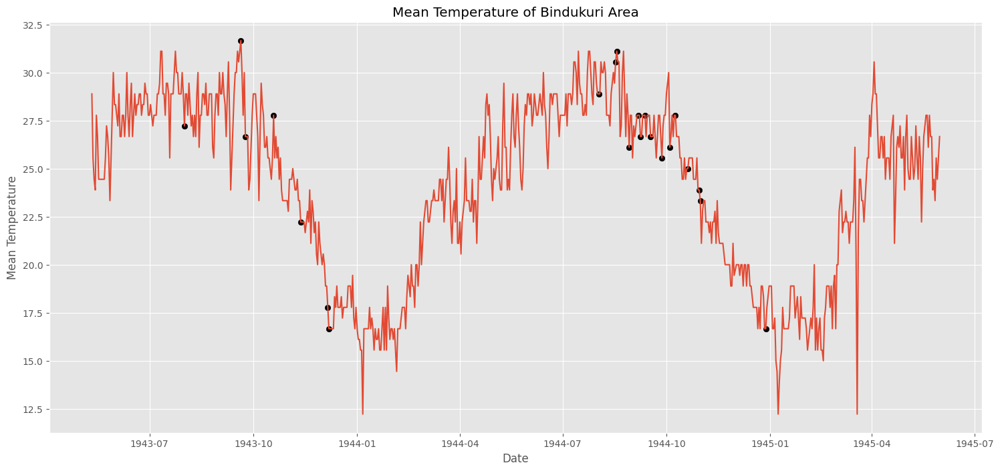

In [142]:
# Fetch the weather station id
station_id = weather_station_location[weather_station_location['NAME'] == 'BINDUKURI']['WBAN']
Burma_station = weather[weather['STA']==station_id.iloc[0]]
# Get war Dates
war = pd.read_csv('operations.csv')
war['year'] = pd.to_datetime(war['Mission Date']).dt.year 
war['month'] = pd.to_datetime(war['Mission Date']).dt.month 
war = war[(war['Country']=='USA')&(war['Target City']=='KATHA')&(war['year']>=1943)&(war['month']>=8)] 
war = Burma_station[Burma_station['Date'].isin(war['Mission Date'])]
# Plot Date Vs Mean Temp
plt.figure(figsize=(18,8))
plt.scatter(war['Date'],war['MeanTemp'],color='black')
plt.plot(Burma_station['Date'],Burma_station['MeanTemp'])
plt.title('Mean Temperature of Bindukuri Area')
plt.xlabel('Date')
plt.ylabel('Mean Temperature')
plt.show()

Time Series Prediction with ARIMA

In [143]:
ts_Burma_station = Burma_station.iloc[:,1:]
ts_Burma_station.index = Burma_station['Date']
ts_Burma_station.drop('Date',axis=1,inplace=True)
ts_Burma_station

,MeanTemp
Date,
1943-05-11,28.888889
1943-05-12,25.555556
1943-05-13,24.444444
1943-05-14,23.888889
1943-05-15,27.777778
...,...
1945-05-27,23.333333
1945-05-28,25.555556
1945-05-29,24.444444


In [136]:
timeseries = weather_bin.loc[:, ['Date', 'MeanTemp']]
timeseries.index = timeseries.Date 
ts = timeseries.drop('Date', axis=1, inplace=True)

<Axes: xlabel='Date'>

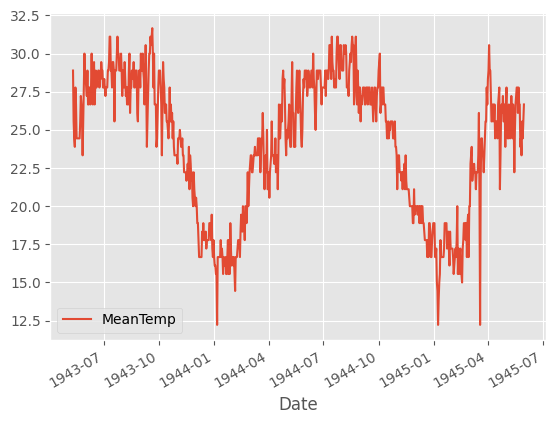

In [144]:
ts_Burma_station.plot()

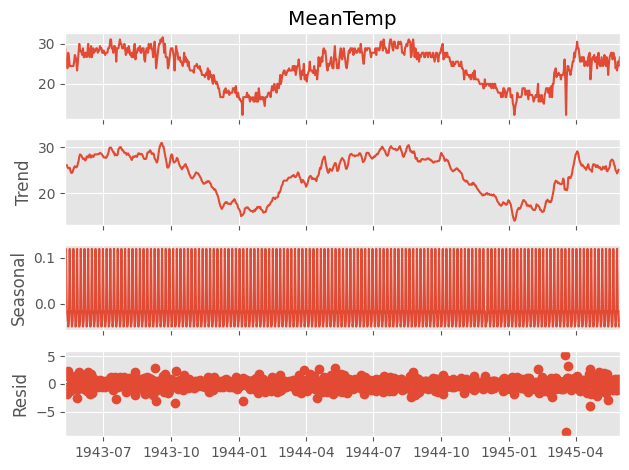

In [149]:
ts_Burma_station_copy = ts_Burma_station.copy()
ts_Burma_station_copy.sort_index(inplace=True)
plot_decompose=seasonal_decompose(ts_Burma_station_copy['MeanTemp'],   period=5)
plot_decompose.plot();

Text(0.5, 1.0, 'Rolling mean & statandard deviation')

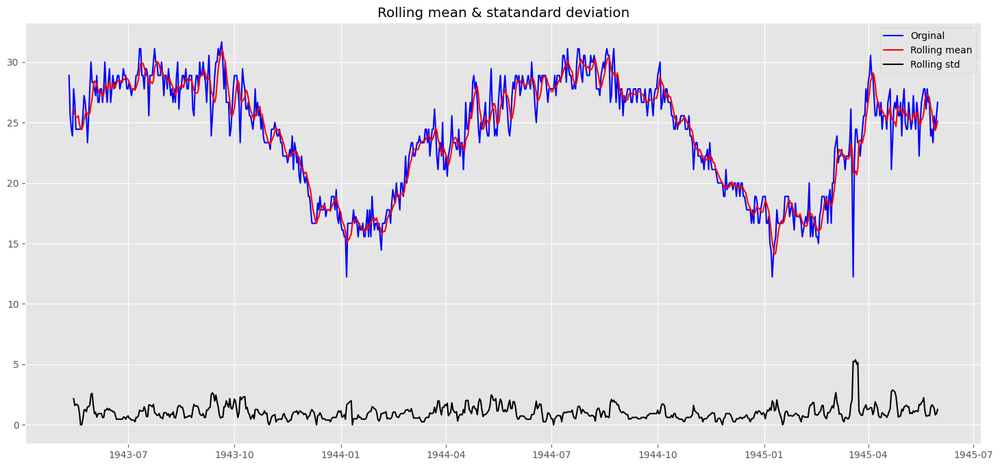

In [150]:
mean_log=ts_Burma_station.rolling(window=5).mean()   
std_log=ts_Burma_station.rolling(window=5).std()
plt.figure(figsize=(18,8))
plt.plot(ts_Burma_station,color='blue',label='Orginal')
plt.plot(mean_log,color='red',label='Rolling mean')
plt.plot(std_log,color='black',label='Rolling std')
plt.legend(loc='best')
plt.title('Rolling mean & statandard deviation')

Therefore mean is not constant
Varience is constant therefore it is stationary

In [155]:
#Performing AD Fuller Test for Stationary Testing
def check_stationarity(ts):
    result = adfuller(ts)
    print("Test Statistics: ",result[0])
    print("P-Value: ", result[1])
    print("Critical Values", result[4])
    if (result[1]<=0.05):
        print("Stationarity is Present")
    else:
        print("Stationarity is not Present")

In [154]:
def plot_ts(ts):   
    rollmean = ts.rolling(window=5).mean()  
    rollstd = ts.rolling(window=5).std()
    plt.figure(figsize=(18,8))
    plt.plot(ts, color = "red",label = "Original")
    plt.plot(rollmean, color='black', label = 'Rolling_mean')
    plt.plot(rollstd, color='green', label = 'Rolling_std')
    plt.title("Mean Temperature of Bindukuri")
    plt.xlabel("Date")
    plt.ylabel("Mean Temperature")
    plt.legend()
    plt.show()

1: Rolling Mean Method

Test Statistics:  -1.4095966745887762
P-Value:  0.5776668028526354
Critical Values {'1%': -3.439229783394421, '5%': -2.86545894814762, '10%': -2.5688568756191392}
Stationarity is not Present


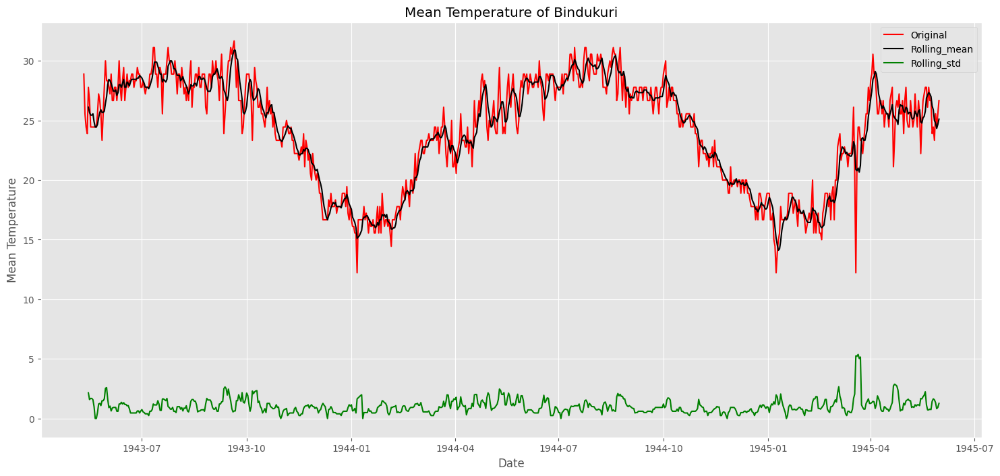

In [156]:
check_stationarity(ts_Burma_station)
plot_ts(ts_Burma_station)

2: Differencing

Test Statistics:  -11.30045138891192
P-Value:  1.311467890176049e-20
Critical Values {'1%': -3.4392418578608983, '5%': -2.86546426916434, '10%': -2.568859710342903}
Stationarity is Present


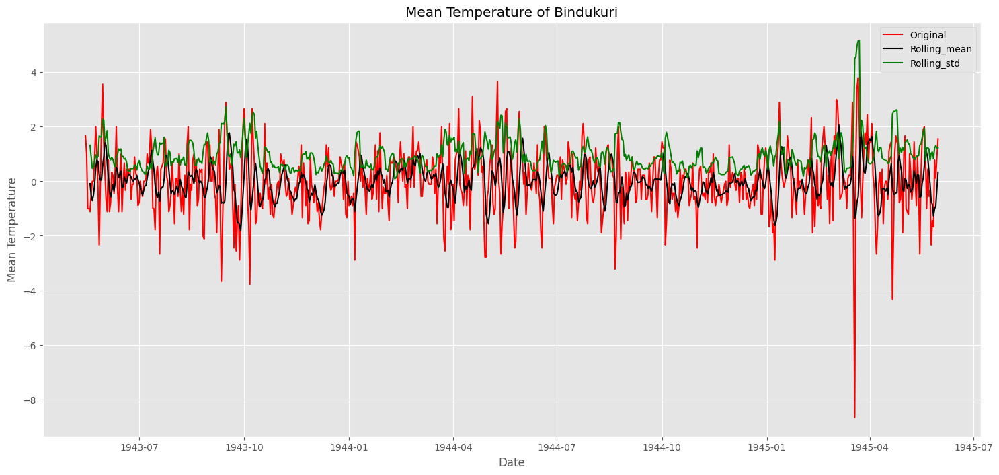

In [157]:
ts_diff = ts_Burma_station - ts_Burma_station.rolling(window=5).mean()
ts_diff.dropna(inplace=True)
check_stationarity(ts_diff)
plot_ts(ts_diff)

3: Log Method

Test Statistics:  -1.9663405060036383
P-Value:  0.30152375810091236
Critical Values {'1%': -3.4391580196774494, '5%': -2.8654273226340554, '10%': -2.5688400274762397}
Stationarity is not Present


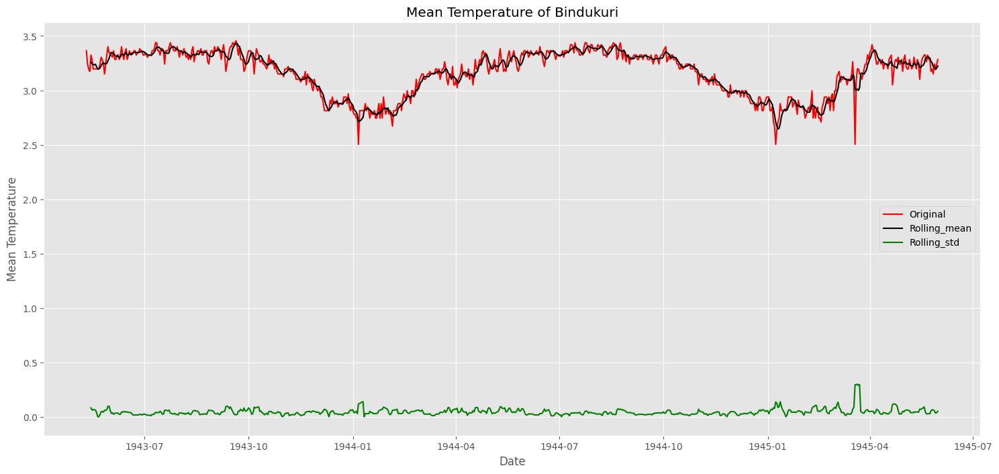

In [159]:
#First order to stablize mean
first_log = np.log(ts_Burma_station)
first_log = first_log.dropna()
check_stationarity(first_log)
plot_ts(first_log)

Test Statistics:  -6.812749685534168
P-Value:  2.0959872610043918e-09
Critical Values {'1%': -3.4393644334758475, '5%': -2.8655182850048306, '10%': -2.568888486973192}
Stationarity is Present


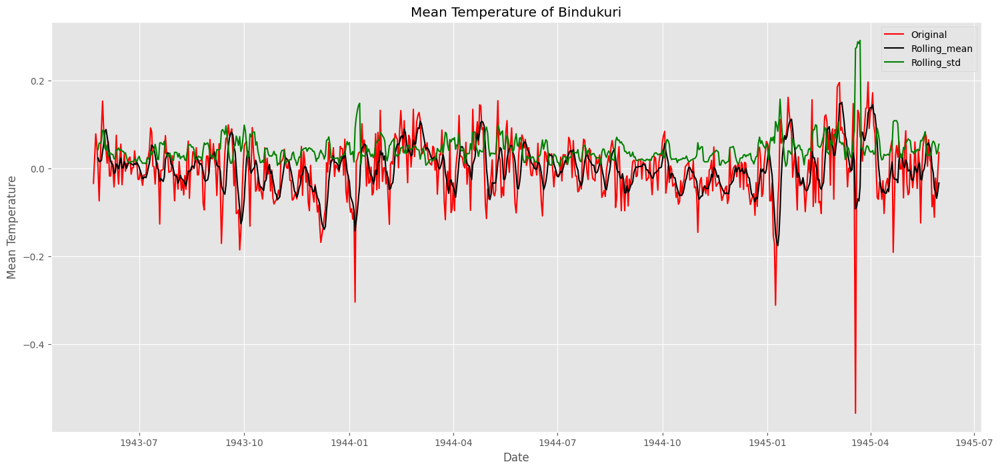

In [160]:
#Second order to remove stationarity
second_log = first_log - first_log.rolling(window=12).mean()
second_log.dropna(inplace=True)
check_stationarity(second_log)
plot_ts(second_log)

Seasonality and Trend after making data stationary

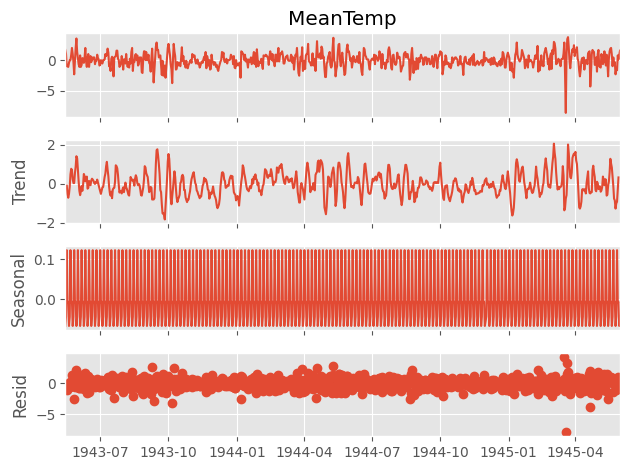

In [164]:
plot_decompose = seasonal_decompose(ts_diff['MeanTemp'], period=5)
plot_decompose.plot();

Auto Correlation Function(ACF) and Partial Auto Correlation Function(PACF)

<function matplotlib.pyplot.tight_layout(*, pad: 'float' = 1.08, h_pad: 'float | None' = None, w_pad: 'float | None' = None, rect: 'tuple[float, float, float, float] | None' = None) -> 'None'>

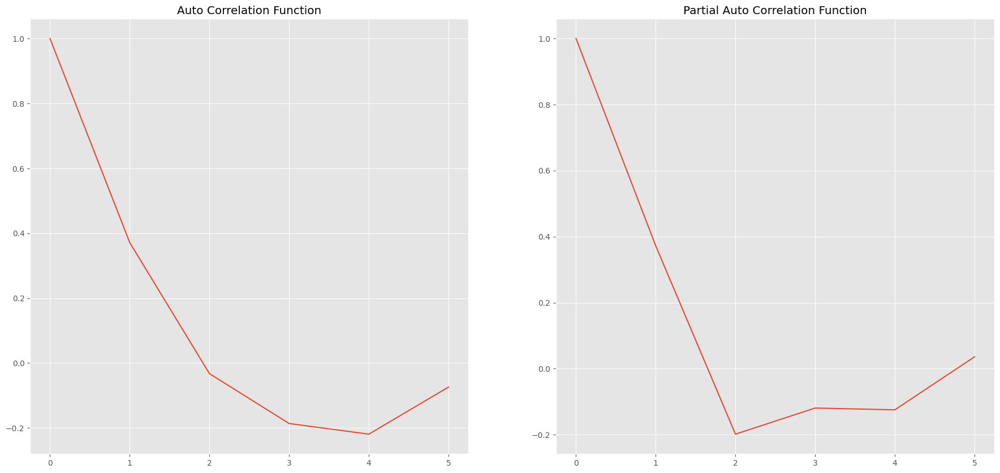

In [165]:
lag_auto_corr = acf(ts_diff, nlags=5)
lag_partial_auto_corr = pacf(ts_diff, nlags=5)

plt.figure(figsize=(22,10))
plt.subplot(121)
plt.plot(lag_auto_corr)
plt.title("Auto Correlation Function")

plt.subplot(122)
plt.plot(lag_partial_auto_corr)
plt.title("Partial Auto Correlation Function")
plt.tight_layout

Figure(640x480)
<function plot_pacf at 0x000002C2D1AB1260>


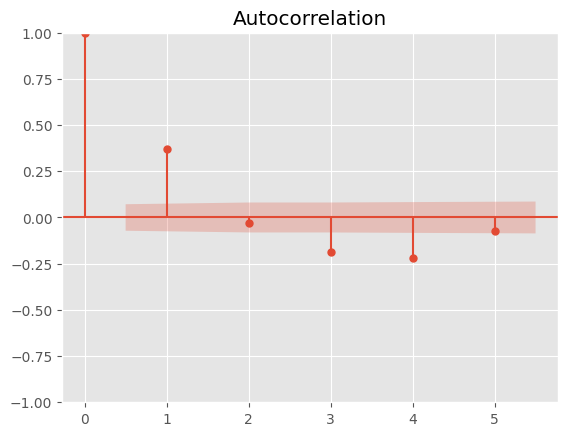

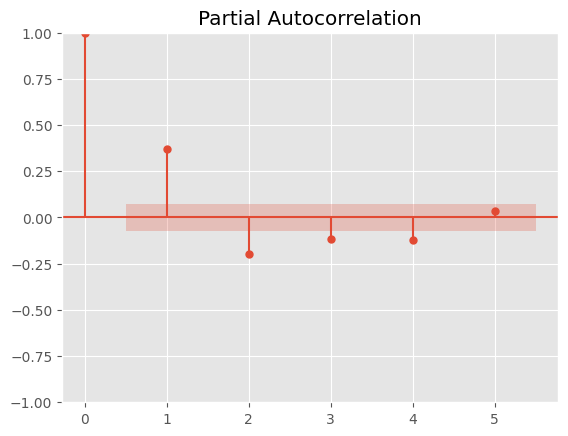

In [166]:
plt_acf = plot_acf(ts_diff.values.squeeze(), lags=5)
plt_pacf = plot_pacf(ts_diff.values.squeeze(), lags=5)

print(plt_acf)
print(plot_pacf)

Cross Validation

In [168]:
mse_scores = []
n_splits = 5
tscv = TimeSeriesSplit(n_splits=n_splits)
for train_index, test_index in tscv.split(ts_diff):
    train_data, test_data = ts_diff.iloc[train_index], ts_diff.iloc[test_index]

    model = ARIMA(train_data, order=(1, 0, 1))
    fitted_model = model.fit()

    predictions = fitted_model.forecast(steps=len(test_data))

    mse = mean_squared_error(test_data, predictions)
    mse_scores.append(mse)

    print("Mean Square Error for current split:{mse}")

average_mse = np.mean(mse_scores)
print("Average Mean Square Error across all splits:{average_mse}")

Mean Square Error for current split:{mse}
Mean Square Error for current split:{mse}
Mean Square Error for current split:{mse}
Mean Square Error for current split:{mse}
Mean Square Error for current split:{mse}
Average Mean Square Error across all splits:{average_mse}


Bulid the ARIMA Model

In [173]:
ts_model = ARIMA(ts_Burma_station, order=(1,0,1))
ts_model_fit  = ts_model.fit()

In [172]:
forecast = ts_model_fit.predict()
error = mean_squared_error(ts_Burma_station, forecast)
print('Error: ' ,error)
forecast

Error:  1.8625810286289943


Date
1943-05-11    24.455516
1943-05-12    28.632790
1943-05-13    26.660005
1943-05-14    25.361547
1943-05-15    24.520481
                ...    
1945-05-27    24.722293
1945-05-28    23.941512
1945-05-29    24.852252
1945-05-30    24.617653
1945-05-31    25.139122
Name: predicted_mean, Length: 751, dtype: float64

Predictions:

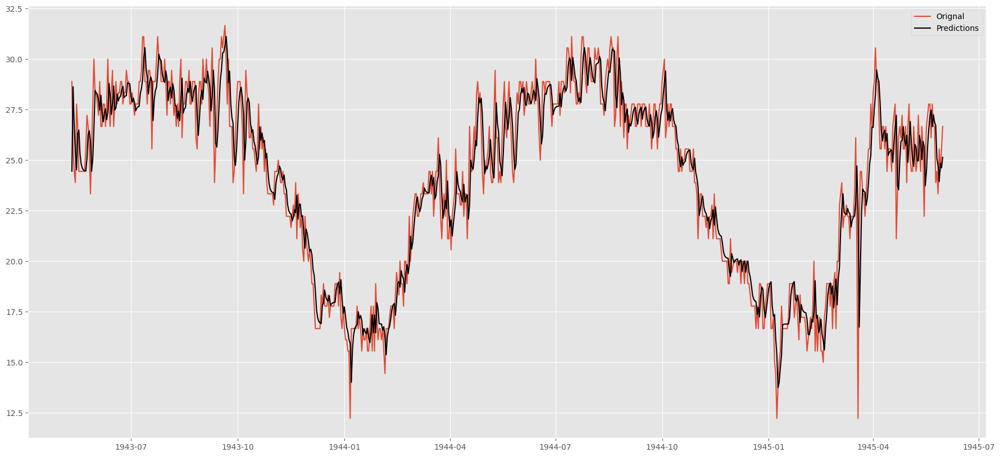

In [175]:
plt.figure(figsize=(22,10))
plt.plot(ts_Burma_station, label="Orignal")
plt.plot(forecast, color='black', label="Predictions")
plt.legend()

Thank You!